### Install dependencies

In [1]:
pip install prettytable cv2 seaborn scikit-learn tensorflow opencv-python-headless scikeras[tensorflow] --quiet

Note: you may need to restart the kernel to use updated packages.


### Import libraries

In [2]:
import pickle
import numpy as np
import pandas as pd
from prettytable import PrettyTable
import matplotlib.pyplot as plt
import sys
import time
import random
import cv2

import sklearn
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, classification_report, accuracy_score
from sklearn.preprocessing import LabelBinarizer

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.callbacks import ModelCheckpoint
from keras import regularizers
from keras.callbacks import EarlyStopping, ReduceLROnPlateau


### Load dataset

In [3]:
## Re-run EDA.ipynb if issues with loading pickle ##
# Load data (binary text labels, size 128x128, 60:20:20 split) 
X_train, X_val, X_test, y_train, y_val, y_test = pd.read_pickle(open("data_binary_128_split_val.pkl", "rb"))

### Data preprocessing

In [4]:
# Print shape of data and labels
print(f'X_train shape: {np.shape(X_train)}')
print(f'X_val shape:   {np.shape(X_val)}')
print(f'X_test shape:  {np.shape(X_test)}')
print(f'y_train shape: {np.shape(y_train)}')
print(f'y_val shape:   {np.shape(y_val)}')
print(f'y_test shape:  {np.shape(y_test)}')

X_train shape: (7401, 128, 128, 3)
X_val shape:   (2467, 128, 128, 3)
X_test shape:  (2467, 128, 128, 3)
y_train shape: (7401,)
y_val shape:   (2467,)
y_test shape:  (2467,)


In [5]:
# Print unique labels
print(f'Unique labels: {np.unique(y_train)}')

Unique labels: ['Fresh' 'Rotten']


In [6]:
# Define parameters for use in the model
img_height = 128
img_width = 128
num_classes = 1 # binary classification

In [8]:
# Encode the labels as binary arrays
lb = LabelBinarizer()

y_train = lb.fit_transform(y_train)
y_val = lb.transform(y_val)
y_test = lb.transform(y_test)

In [9]:
# Calculate mean and standard deviation of the training data
mean = np.mean(X_train, axis=(0, 1, 2))
std = np.std(X_train, axis=(0, 1, 2))

# Standardize the data
X_train = (X_train - mean) / std
X_val = (X_val - mean) / std
X_test = (X_test - mean) / std

### Build and train the CNN classifier

In [14]:
model = keras.models.Sequential()

model.add(keras.layers.Conv2D(32, (3, 3), activation = 'relu', input_shape = (img_height, img_width, 3)))
model.add(keras.layers.MaxPooling2D((2, 2)))

model.add(keras.layers.Conv2D(64, (3, 3), activation = 'relu'))
model.add(keras.layers.MaxPooling2D((2, 2)))

model.add(keras.layers.Conv2D(128, (3, 3), activation = 'relu'))
model.add(keras.layers.MaxPooling2D((2, 2)))

model.add(keras.layers.Conv2D(256, (3, 3), activation = 'relu'))
model.add(keras.layers.MaxPooling2D((2, 2)))

model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(256, activation = 'relu'))
model.add(keras.layers.Dropout(0.5))
model.add(keras.layers.Dense(128, activation = 'relu'))
model.add(keras.layers.Dropout(0.5))
model.add(keras.layers.Dense(num_classes, activation = 'sigmoid'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 28, 28, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 14, 14, 128)      0

In [15]:
# Compile the model
model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

In [16]:
# Define a callback to save the model after every epoch
checkpoint = ModelCheckpoint('my_model.h5', save_best_only = True)

# Train the model 
%time history = model.fit(X_train, y_train, batch_size = 32, epochs = 20, validation_data = (X_val, y_val), callbacks = [checkpoint])

Epoch 1/20
232/232 [==============================] - 31s 128ms/step - loss: 0.4330 - accuracy: 0.7962 - val_loss: 0.3385 - val_accuracy: 0.8504
Epoch 2/20
232/232 [==============================] - 28s 123ms/step - loss: 0.2640 - accuracy: 0.8924 - val_loss: 0.2002 - val_accuracy: 0.9185
Epoch 3/20
232/232 [==============================] - 28s 120ms/step - loss: 0.2014 - accuracy: 0.9201 - val_loss: 0.2114 - val_accuracy: 0.9104
Epoch 4/20
232/232 [==============================] - 28s 120ms/step - loss: 0.1616 - accuracy: 0.9388 - val_loss: 0.2087 - val_accuracy: 0.9218
Epoch 5/20
232/232 [==============================] - 28s 120ms/step - loss: 0.1255 - accuracy: 0.9523 - val_loss: 0.1182 - val_accuracy: 0.9542
Epoch 6/20
232/232 [==============================] - 28s 122ms/step - loss: 0.0842 - accuracy: 0.9682 - val_loss: 0.1217 - val_accuracy: 0.9534
Epoch 7/20
232/232 [==============================] - 28s 123ms/step - loss: 0.0882 - accuracy: 0.9688 - val_loss: 0.1020 - val_ac

### Training evaluation

#### Accuracy

78/78 - 2s - loss: 0.1266 - accuracy: 0.9728 - 2s/epoch - 24ms/step


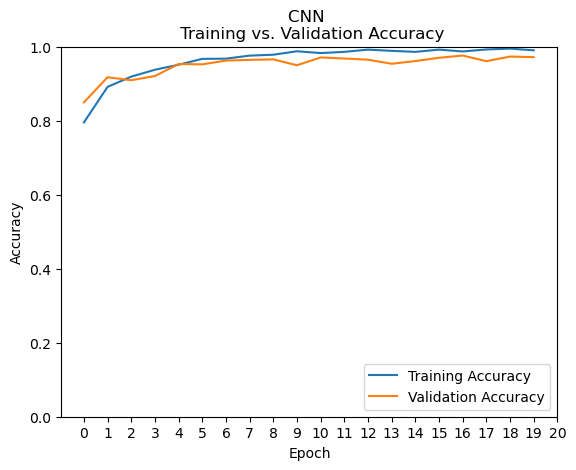

In [37]:
# Evaluate model accuracy (train vs. val)
plt.plot(history.history['accuracy'], label = 'Training Accuracy')
plt.plot(history.history['val_accuracy'], label = 'Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('CNN \n Training vs. Validation Accuracy')
plt.ylim([0, 1])
plt.xticks(np.arange(0, 20 + 1, 1.0))
plt.legend(loc = 'lower right')

validation_loss, validation_acc = model.evaluate(X_val,  y_val, verbose = 2)

#### Loss

78/78 - 2s - loss: 0.1266 - accuracy: 0.9728 - 2s/epoch - 24ms/step


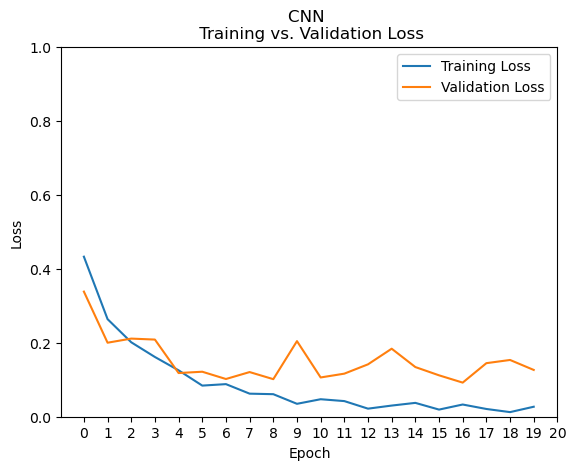

In [36]:
# Evaluate loss (train vs. val)
plt.plot(history.history['loss'], label = 'Training Loss')
plt.plot(history.history['val_loss'], label = 'Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('CNN \n Training vs. Validation Loss')
plt.ylim([0, 1])
plt.xticks(np.arange(0, 20 + 1, 1.0))
plt.legend(loc = 'upper right')

validation_loss, validation_acc = model.evaluate(X_val,  y_val, verbose = 2)

In [19]:
# Print validation accuracy and loss
print(f'Validation Accuracy: {validation_acc} \nValidation Loss: {validation_loss}' )

Validation Accuracy: 0.9728415012359619 
Validation Loss: 0.1265823096036911


### Predict and evaluate performance on test set (out-of-sample)

#### Predict on the test set

In [24]:
# Predict the labels for the test set
y_pred = model.predict(X_test)
y_pred = (y_pred > 0.5).astype(int)

78/78 [==============================] - 2s 22ms/step


#### Confusion matrix

In [25]:
# Compute the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Create a PrettyTable object
table = PrettyTable()
table.field_names = [' ', 'Predicted 0', 'Predicted 1']
table.add_row(['Actual 0', conf_matrix[0][0], conf_matrix[0][1]])
table.add_row(['Actual 1', conf_matrix[1][0], conf_matrix[1][1]])

# Print the confusion matrix
print('Confusion matrix:')
print(table)

Confusion matrix:
+----------+-------------+-------------+
|          | Predicted 0 | Predicted 1 |
+----------+-------------+-------------+
| Actual 0 |     1208    |      48     |
| Actual 1 |      7      |     1204    |
+----------+-------------+-------------+


#### Classification report

In [26]:
# Compute the classification report
test_report = classification_report(y_test, y_pred, output_dict = True)
test_table = PrettyTable(['Class', 'Precision', 'Recall', 'F1-score', 'Support'])

# Iterate over the report items and add rows to the table
for label, score in test_report.items():
    if label == 'accuracy':
        continue
    # Round the scores to three decimal places
    precision = round(score['precision'], 4)
    recall = round(score['recall'], 4)
    f1_score = round(score['f1-score'], 4)
    support = score['support']

    # Add the rounded scores to the table
    test_table.add_row([label, precision, recall, f1_score, support])

# Print the classification report
print('Classification Report (training data):')
print(test_table)

Classification Report (training data):
+--------------+-----------+--------+----------+---------+
|    Class     | Precision | Recall | F1-score | Support |
+--------------+-----------+--------+----------+---------+
|      0       |   0.9942  | 0.9618 |  0.9777  |   1256  |
|      1       |   0.9617  | 0.9942 |  0.9777  |   1211  |
|  macro avg   |   0.978   | 0.978  |  0.9777  |   2467  |
| weighted avg |   0.9782  | 0.9777 |  0.9777  |   2467  |
+--------------+-----------+--------+----------+---------+


#### Plot example images (TP, TN, FP, FN)

In [18]:
# Counter for names of images to save to file
counter = 0

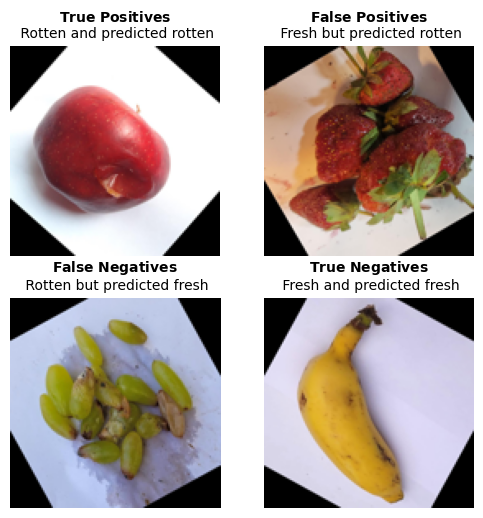

In [59]:
# Create a 'confusion matrix' of example images from each correct/error category

# Get the indices of each category
fresh_fresh_idx = np.where((y_test == 0) & (y_pred == 0))[0]
rotten_fresh_idx = np.where((y_test == 1) & (y_pred == 0))[0]
fresh_rotten_idx = np.where((y_test == 0) & (y_pred == 1))[0]
rotten_rotten_idx = np.where((y_test == 1) & (y_pred == 1))[0]

# Choose one random example from each category
fresh_fresh_sample = X_test[random.choice(fresh_fresh_idx)]
rotten_fresh_sample = X_test[random.choice(rotten_fresh_idx)]
fresh_rotten_sample = X_test[random.choice(fresh_rotten_idx)]
rotten_rotten_sample = X_test[random.choice(rotten_rotten_idx)]


# Scale the pixel values back to the original range
fresh_fresh_sample_rescaled = (fresh_fresh_sample * std) + mean
rotten_fresh_sample_rescaled = (rotten_fresh_sample * std) + mean
fresh_rotten_sample_rescaled = (fresh_rotten_sample * std) + mean
rotten_rotten_sample_rescaled = (rotten_rotten_sample * std) + mean

# Plot example image - True Positive
plt.figure(figsize = (6,6))
plt.subplot(221)
plt.imshow(rotten_rotten_sample_rescaled)
plt.title(r"$\bf{True\ Positives}$" + "\n Rotten and predicted rotten", fontsize = 10)
plt.axis('off')

# Plot example image - False Positive
plt.subplot(222)
plt.imshow(fresh_rotten_sample_rescaled)
plt.title(r"$\bf{False\ Positives}$" + "\n Fresh but predicted rotten", fontsize = 10)
plt.axis('off')

# Plot example image - False Negative
plt.subplot(223)
plt.imshow(rotten_fresh_sample_rescaled)
plt.title(r"$\bf{False\ Negatives}$" + "\n Rotten but predicted fresh", fontsize = 10)
plt.axis('off')

# Plot example image - True Negative
plt.subplot(224)
plt.imshow(fresh_fresh_sample_rescaled)
plt.title(r"$\bf{True\ Negatives}$" + "\n Fresh and predicted fresh", fontsize = 10)
plt.axis('off')

# Save plot to files
#counter += 1
#path_orig = f"{counter}-original.png"
#plt.savefig(path_orig)

# Show plot
plt.show()

### Complexity analysis - Baseline Model Comparison

In [10]:
# Define the baseline model
model_baseline = keras.models.Sequential([
    keras.layers.Conv2D(32, kernel_size = (3, 3), activation = "relu", input_shape = (img_height, img_width, 3)),
    keras.layers.MaxPooling2D(pool_size = (2, 2)),
    keras.layers.Conv2D(64, kernel_size = (3, 3), activation = "relu"),
    keras.layers.MaxPooling2D(pool_size = (2, 2)),
    keras.layers.Flatten(),
    keras.layers.Dense(128, activation = "relu"),
    keras.layers.Dense(num_classes, activation = "sigmoid")
])

# Print the model summary
model_baseline.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 57600)             0         
                                                                 
 dense (Dense)               (None, 128)               7

In [ ]:
# Compile the model
model_baseline.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

# Fit the baseline model
%time model_baseline.fit(X_train, y_train, batch_size = 32, epochs = 10, validation_data = (X_val, y_val))
print()

# Evaluate the baseline model
y_test_pred_base = model_baseline.predict(X_test)
y_test_pred_base = (y_test_pred_base > 0.5).astype(int)

Epoch 1/10
232/232 [==============================] - 24s 100ms/step - loss: 0.3800 - accuracy: 0.8547 - val_loss: 0.2582 - val_accuracy: 0.9007
Epoch 2/10
232/232 [==============================] - 22s 95ms/step - loss: 0.1730 - accuracy: 0.9303 - val_loss: 0.1870 - val_accuracy: 0.9295
Epoch 3/10
232/232 [==============================] - 22s 95ms/step - loss: 0.1188 - accuracy: 0.9545 - val_loss: 0.1728 - val_accuracy: 0.9311
Epoch 4/10
232/232 [==============================] - 22s 94ms/step - loss: 0.0725 - accuracy: 0.9714 - val_loss: 0.1340 - val_accuracy: 0.9587
Epoch 5/10
232/232 [==============================] - 22s 95ms/step - loss: 0.0506 - accuracy: 0.9824 - val_loss: 0.1626 - val_accuracy: 0.9433
Epoch 6/10
232/232 [==============================] - 22s 96ms/step - loss: 0.0335 - accuracy: 0.9876 - val_loss: 0.1814 - val_accuracy: 0.9501
Epoch 7/10
232/232 [==============================] - 22s 95ms/step - loss: 0.0237 - accuracy: 0.9932 - val_loss: 0.1831 - val_accuracy

In [49]:
# Compute the classification report
base_test_report = classification_report(y_test, y_test_pred_base, output_dict=True)

# Create pretty table
base_test_table = PrettyTable()
headers = ['Performance measure', 'Label 0: Fresh', 'Label 1: Rotten']
measure_names = ['Precision', 'Recall', 'F1', 'Support']

# Add columns to table
base_test_table.add_column(headers[0], measure_names)
base_test_table.add_column(headers[1], [round(num, 4) for num in base_test_report['0'].values()])
base_test_table.add_column(headers[2], [round(num, 4) for num in base_test_report['1'].values()])

# Print performance measure table and accuracy for both models
print(f"\nPerformance Measure Table (CNN Baseline Model, Test Data): \n{base_test_table}")
print(f"\nCNN Baseline Model Overall Accuracy Score: {accuracy_score(y_test, y_test_pred_base).round(4)}\n")


Performance Measure Table (CNN Baseline Model, Test Data): 
+---------------------+----------------+-----------------+
| Performance measure | Label 0: Fresh | Label 1: Rotten |
+---------------------+----------------+-----------------+
|      Precision      |     0.9545     |      0.9681     |
|        Recall       |     0.9697     |      0.9521     |
|          F1         |     0.9621     |       0.96      |
|       Support       |      1256      |       1211      |
+---------------------+----------------+-----------------+

CNN Baseline Model Overall Accuracy Score: 0.9611



### Grad-CAM
Adapted from the following Grad-CAM implementation, which is based on the original paper https://github.com/ismailuddin/gradcam-tensorflow-2

In [20]:
# Duplicate the CNN model
grad_model = tf.keras.models.clone_model(model)

In [82]:
# Get the outputs of the last convolutional layer
last_conv_layer = grad_model.get_layer("conv2d_3")

# Build a model that only goes up to this layer 
last_conv_layer_model = tf.keras.Model(grad_model.inputs, last_conv_layer.output)

# Build new model that takes output from last_conv_layer_model and uses the layers after last pooling layer to get the final predictions.
classifier_input = tf.keras.Input(shape=last_conv_layer.output.shape[1:])
x = classifier_input
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
classifier_output = tf.keras.layers.Dense(num_classes, activation='sigmoid')(x)
classifier_model = tf.keras.Model(classifier_input, classifier_output)

In [83]:
# Define function to show the Grad-CAM visualisation for a specified image
def display_grad_cam(image, cmap='inferno_r', alpha=0.5):
    with tf.GradientTape() as tape:
        # Get output from the model up to the last convolution layer and ask tf to watch this tensor output
        inputs = np.array([image])
        last_conv_layer_output = last_conv_layer_model(inputs)
        tape.watch(last_conv_layer_output)
        preds = classifier_model(last_conv_layer_output)
        top_pred_index = tf.argmax(preds[0])
        top_class_channel = preds[:, top_pred_index]

    # Calculate gradients of predictions of target class wrt to last convolution layer model output
    grads = tape.gradient(top_class_channel, last_conv_layer_output)

    # Average and flatten
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Multiply the feature map by the gradients
    last_conv_layer_output = last_conv_layer_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()
    for i in range(pooled_grads.shape[-1]):
        last_conv_layer_output[:, :, i] *= pooled_grads[i]

    # Average over all the filters to get a single 2D array
    gradcam = np.mean(last_conv_layer_output, axis=-1)
    
    # Clip (equivalent to applying ReLU) and normalise the values
    gradcam = np.clip(gradcam, 0, np.max(gradcam)) / np.max(gradcam)
    
    # Resize the Grad-CAM to the size of the original image
    gradcam = cv2.resize(gradcam, (128, 128))    

    # Show Grad-CAM overlayed over the original image
    plt.imshow(image)
    plt.imshow(gradcam, cmap=cmap, alpha=alpha)
    
    return

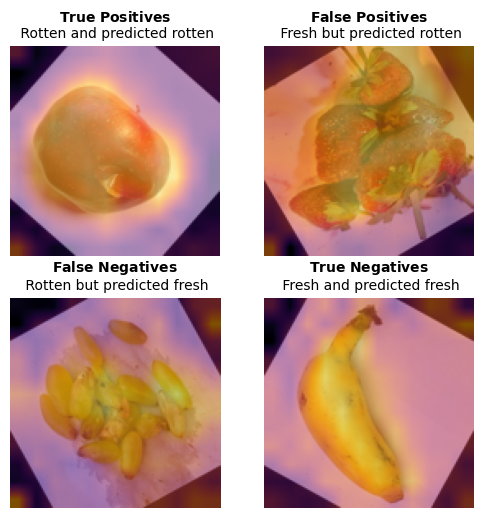

In [84]:
# Use display_grad_cam to create a 'confusion matrix' with pictures 

# Plot True Positive (Fresh + predicted fresh)
plt.figure(figsize = (6,6))
plt.subplot(221)
display_grad_cam(rotten_rotten_sample_rescaled)
plt.title(r"$\bf{True\ Positives}$" + "\n Rotten and predicted rotten", fontsize = 10)
plt.axis('off')

# Plot False Positive (Rotten + predicted fresh)
plt.subplot(222)
display_grad_cam(fresh_rotten_sample_rescaled)
plt.title(r"$\bf{False\ Positives}$" + "\n Fresh but predicted rotten", fontsize = 10)
plt.axis('off')

# Plot False Negative (Fresh + predicted rotten)
plt.subplot(223)
display_grad_cam(rotten_fresh_sample_rescaled)
plt.title(r"$\bf{False\ Negatives}$" + "\n Rotten but predicted fresh", fontsize = 10)
plt.axis('off')

# Plot True Negative (Rotten + predicted rotten)
plt.subplot(224)
display_grad_cam(fresh_fresh_sample_rescaled)
plt.title(r"$\bf{True\ Negatives}$" + "\n Fresh and predicted fresh", fontsize = 10)
plt.axis('off')

# Save plot to files
#path_grad = f"{counter}-grad.png"
#plt.savefig(path_grad)

# Show the plot
plt.show()

------

### Inspect Grad-CAM vs original images

#### Inspect all false positives and false negatives

In [85]:
print(f"Num false negatives: {len(rotten_fresh_idx)}")
print(f"Number false positives: {len(fresh_rotten_idx)}")

Num false negatives: 70
Number false positives: 19


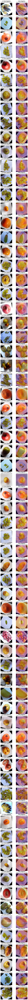

In [86]:
# Plot all actually-rotten + predicted-fresh to inspect

plt.figure(figsize = (6,3*len(rotten_fresh_idx)))

for i in range(len(rotten_fresh_idx)):
    plt.subplot(int(len(rotten_fresh_idx)+1), 2, int(2*i+1))
    plt.imshow((X_test[rotten_fresh_idx[i]] * std) + mean)
    plt.title(f"{[i]} " + r"$\bf{False\ Negative}$" + "\n Rotten and predicted fresh", fontsize = 10)
    plt.axis('off')
    
    plt.subplot(int(len(rotten_fresh_idx)+1), 2, int(2*i+2))
    display_grad_cam((X_test[rotten_fresh_idx[i]] * std) + mean)
    plt.title(r"$\bf{False\ Negative}$" + "\n Rotten and predicted fresh", fontsize = 10)
    plt.axis('off')
    
plt.show()

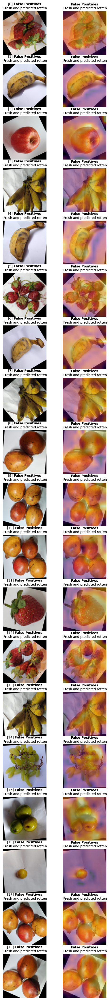

In [87]:
# Plot all actually-fresh + predicted-rotten to inspect

plt.figure(figsize = (6,3*len(fresh_rotten_idx)))

for i in range(len(fresh_rotten_idx)):
    plt.subplot(int(len(fresh_rotten_idx)+1), 2, int(2*i+1))
    plt.imshow((X_test[fresh_rotten_idx[i]] * std) + mean)
    plt.title(f"{[i]} " + r"$\bf{False\ Positives}$" + "\n Fresh and predicted rotten", fontsize = 10)
    plt.axis('off')
    
    plt.subplot(int(len(fresh_rotten_idx)+1), 2, int(2*i+2))
    display_grad_cam((X_test[fresh_rotten_idx[i]] * std) + mean)
    plt.title(r"$\bf{False\ Positives}$" + "\n Fresh and predicted rotten", fontsize = 10)
    plt.axis('off')
    
plt.show()

#### Inspect subsets of true positives and true negatives

In [88]:
print(f"Num true positives: {len(rotten_rotten_idx)}")
print(f"Number true negatives: {len(fresh_fresh_idx)}")

Num true positives: 1141
Number true negatives: 1237


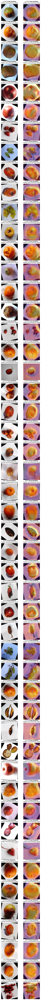

In [89]:
# Plot subset of actually-rotten + predicted-rotten to inspect

plt.figure(figsize = (6,3*50))

for i in range(50):
    ran_idx = random.choice(rotten_rotten_idx)
    
    plt.subplot(51, 2, int(2*i+1))
    plt.imshow((X_test[ran_idx] * std) + mean)
    plt.title(f"{[ran_idx]} " + r"$\bf{True\ Positive}$" + "\n Rotten and predicted rotten", fontsize = 10)
    plt.axis('off')
    
    plt.subplot(51, 2, int(2*i+2))
    display_grad_cam((X_test[ran_idx] * std) + mean)
    plt.title(f"{[ran_idx]} " + r"$\bf{True\ Positive}$" + "\n Rotten and predicted rotten", fontsize = 10)
    plt.axis('off')
    
plt.show()

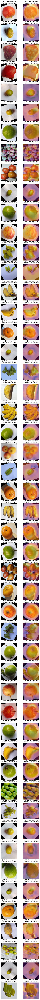

In [90]:
# Plot subset of actually-fresh + predicted-fresh to inspect

plt.figure(figsize = (6,3*50))

for i in range(50):
    ran_idx = random.choice(fresh_fresh_idx)
    
    plt.subplot(51, 2, int(2*i+1))
    plt.imshow((X_test[ran_idx] * std) + mean)
    plt.title(f"{[ran_idx]} " + r"$\bf{True\ Negative}$" + "\n Fresh and predicted fresh", fontsize = 10)
    plt.axis('off')
    
    plt.subplot(51, 2, int(2*i+2))
    display_grad_cam((X_test[ran_idx] * std) + mean)
    plt.title(f"{[ran_idx]} " + r"$\bf{True\ Negative}$" + "\n Fresh and predicted fresh", fontsize = 10)
    plt.axis('off')
    
plt.show()

(-0.5, 127.5, 127.5, -0.5)

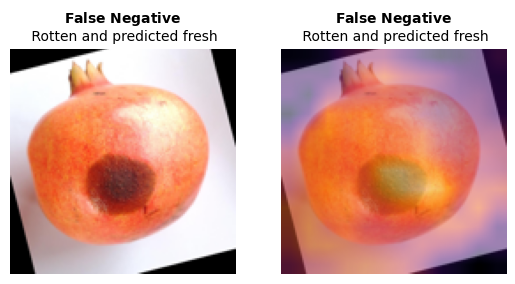

In [91]:
# Print misclassified pomegranate example
plt.subplot(1, 2, 1)
plt.imshow((X_test[rotten_fresh_idx[2]] * std) + mean)
plt.title(r"$\bf{False\ Negative}$" + "\n Rotten and predicted fresh", fontsize = 10)
plt.axis('off')

plt.subplot(1, 2, 2)
display_grad_cam((X_test[rotten_fresh_idx[2]] * std) + mean)
plt.title(r"$\bf{False\ Negative}$" + "\n Rotten and predicted fresh", fontsize = 10)
plt.axis('off')

plt.show()